# Getting Started with CellRank

In this tutorial, you will learn how to:

+ Use CellRank kernels to compute a transition matrix of cellular dynamics.

+ Use CellRank estimators to analyze the transition matrix, including the computation of fate probabilities, driver genes, and gene expression trends.

+ Read and write CellRank kernels.

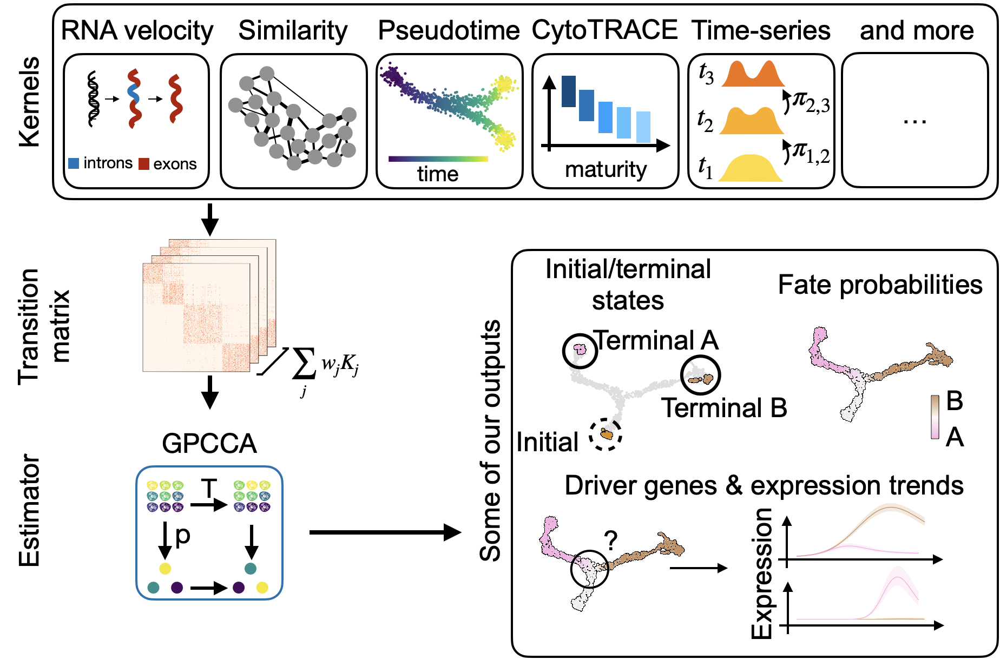

In [68]:
#!pip install matplotlib==3.7
#!pip install pandas==1.4.1 # for categorical property 

# Import packages & data

In [1]:
import cellrank as cr
import numpy as np
import scipy.stats as st

import scanpy as sc
import scanpy as sc
import pandas as pd
#import cellrank as cr
import scvelo as scv
import loompy
sc.settings.set_figure_params(frameon=False, dpi=100)
cr.settings.verbosity = 2

In [2]:
import warnings

warnings.simplefilter("ignore", category=UserWarning)

In [3]:
adata = scv.read('/home/aruna/Desktop/Analysis/Project1/Data/Project1&DynVelo.h5ad', cache=True)
adata

AnnData object with n_obs × n_vars = 46110 × 1102
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'condition', 'cell_type', 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes', 'spearmans_score', 'velocity_score'
    uns: 'batch_colors', 'cell_type_colors', 'c

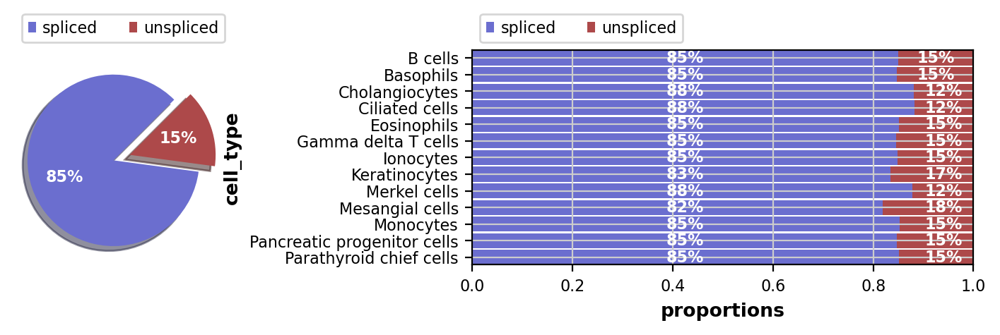

AnnData object with n_obs × n_vars = 46110 × 1102
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'condition', 'cell_type', 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes', 'spearmans_score', 'velocity_score'
    uns: 'batch_colors', 'cell_type_colors', 'c

In [4]:
scv.pl.proportions(adata, groupby="cell_type")
adata

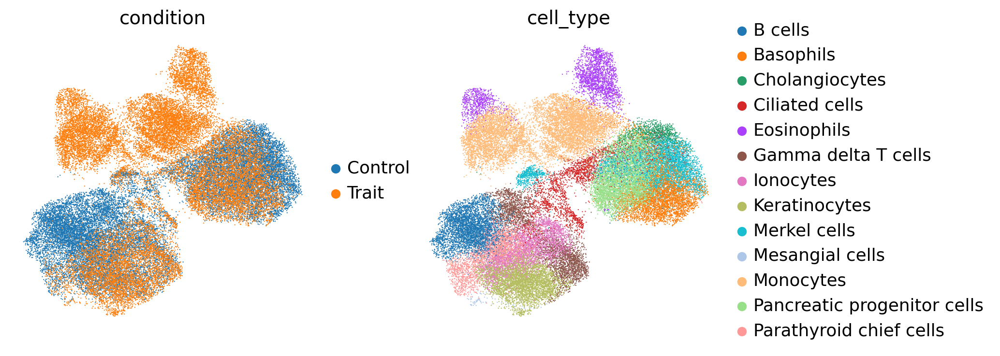

In [5]:
sc.pl.embedding(adata, basis="umap", color=["condition", "cell_type"])

The scVelo’s dynamical model was runned to estimate model parameters in the **`RNA velocity pipeline`**.

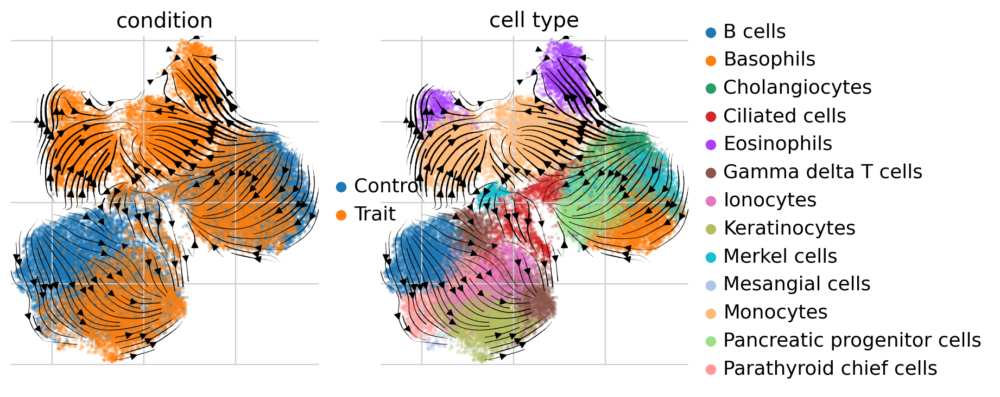

In [5]:
scv.pl.velocity_embedding_stream(adata, basis='umap', color=['condition','cell_type'], 
                                 legend_loc='right margin')

We’ll use CellRank to visualize the velocities in an embedding further down below.

# Combine RNA velocity with expression similarity in high dimensions

### Set up the VelocityKernel

Set up the VelocityKernel from the AnnData object containing the scVelo-computed velocities.

+ **Kernel overview**

There exist CellRank kernels for many different data modalities. Each modality and biological system comes with its own strenghts and limitations, so it’s important to choose the kernel carefully. We provide some guidance in the figure below. However, please check the kernel API for a complete and up-to-date list, as new kernels will come.

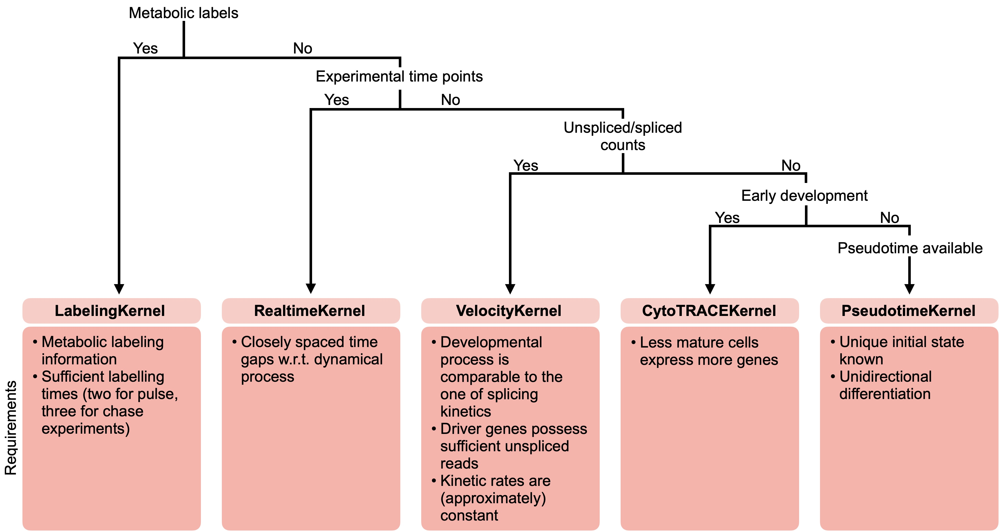

In [5]:
vk = cr.kernels.VelocityKernel(adata)

Use the VelocityKernel to compute a transition matrix by correlating each cell’s velocity vector with the displacement vectors towards nearest neighbors, directly in high-dimensional gene expression space.

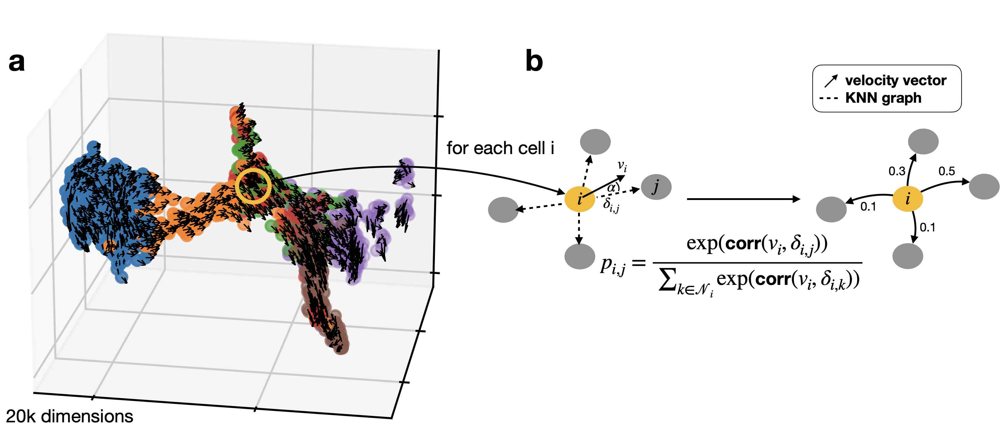

**Computing transition probabilities**: We correlate each cell’s velocity vector with the transcriptomic displacement vectors towards nearest neighbors.

We do this using the compute_transition_matrix() method.

In [6]:
vk.compute_transition_matrix()

Computing transition matrix using `'deterministic'` model


  0%|          | 0/46110 [00:00<?, ?cell/s]

Using `softmax_scale=8.9981`


  0%|          | 0/46110 [00:00<?, ?cell/s]

    Finish (0:00:36)


VelocityKernel[n=46110, model='deterministic', similarity='correlation', softmax_scale=8.998]

By default, we use the deterministic mode to compute the transiton matrix. If you want to propagate uncertainty in the velocity vectors, check out the stochastic and monte_carlo modes. The stochastic mode estimates a distribution over velocity vectors using the KNN graph and propagates this distribution into the transition matrix using an analytical approximation.

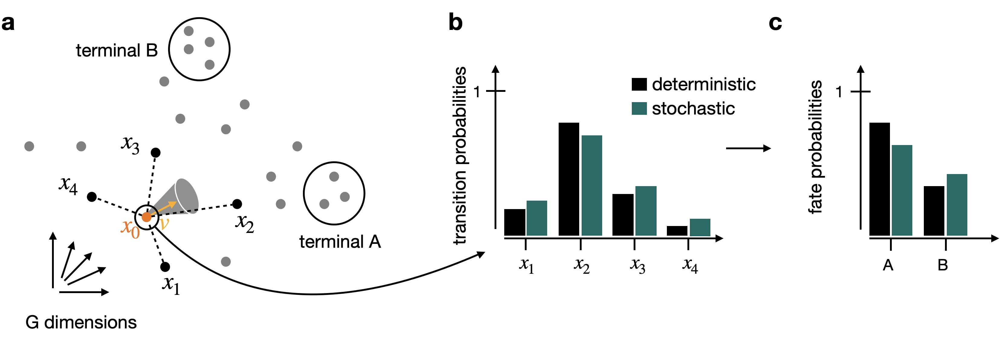
**Propagating velocity uncertainty**: CellRank can propagate estimated velocity uncertainties into transition probabilities.

### Combine with gene expression similarity

RNA velocity can be a very noise quantity; to make our computations more robust, we combine the VelocityKernel with the similarity-based ConnectivityKernel.



In [7]:
ck = cr.kernels.ConnectivityKernel(adata)
ck.compute_transition_matrix()

combined_kernel = 0.8 * vk + 0.2 * ck

Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)


Above, we combined the two kernels with custom weights given to each. The same syntax can be used to combine any number of CellRank kernels, see the getting started tutorial.

Let’s print the combined kernel object to see what it contains:

In [8]:
print(combined_kernel)

(0.8 * VelocityKernel[n=46110] + 0.2 * ConnectivityKernel[n=46110])


This tells us about the kernels we combined, the weights we used to combine them, and the parameters that went into transition matrix computation for each kernel. Check out the API to learn more about the parameters. Next, let’s explore ways to visualize the computed transition matrix.

### Visualize the transition matrix
Similar to scvelo [Bergen et al., 2020] and velocyto [La Manno et al., 2018], CellRank visualizes the transition matrix in any low dimensional embedding (UMAP, t-SNE, PCA, Diffmap, etc.) via arrows or streamlines.

Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:07)


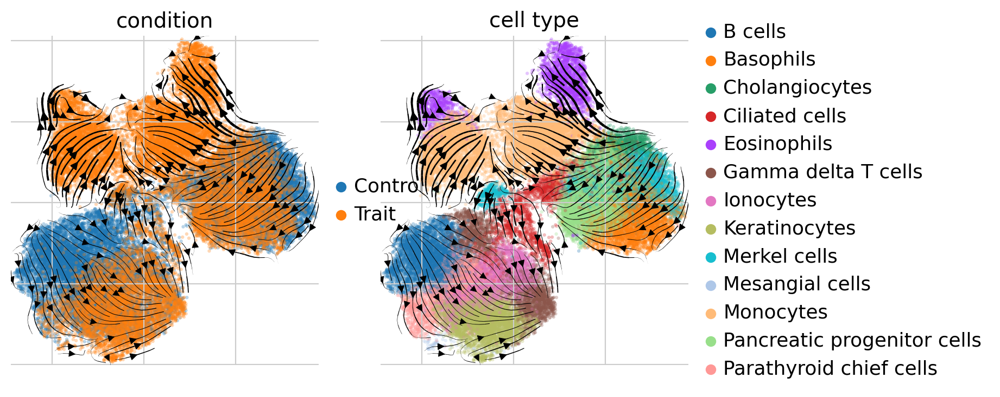

In [9]:
vk.plot_projection(color=['condition','cell_type'], 
                                 legend_loc='right margin')

As shown before in the scVelo publication [Bergen et al., 2020], the projected velocity vectors capture the overall trend in this system: Neurogenin 3 low endocrine progenitor cells (Ngn3 low EP) gradually transition via indermediate stages towards terminal, hormone producing Alpha, Beta, Epsilon and Delta cells. Another way to visualize this is via random walks.

Simulating `100` random walks of maximum length `200`


  0%|          | 0/100 [00:00<?, ?sim/s]

    Finish (0:00:06)
Plotting random walks


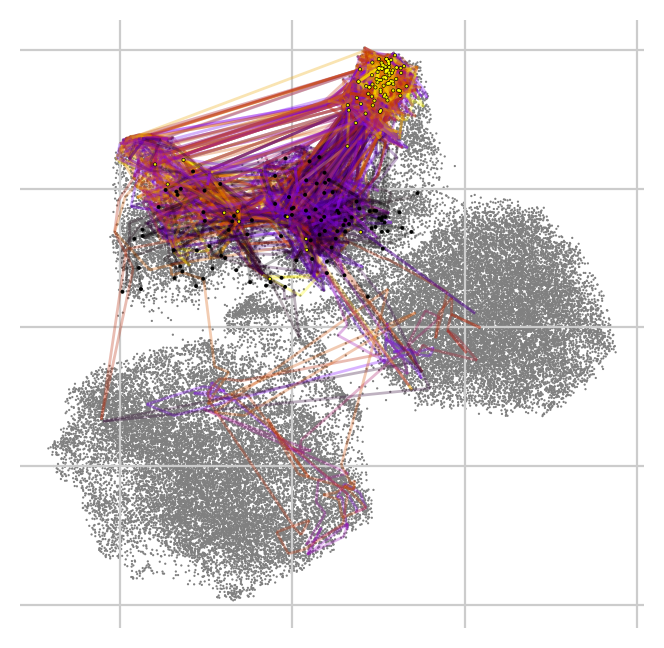

In [11]:
vk.plot_random_walks(start_ixs={"cell_type": "Monocytes"}, max_iter=200, seed=0)

# Identify initial and terminal states
## Initialize an estimator
The estimators allow you to analyze cell-state dynamics in CellRank. We initialize the GPCCA estimator here by passing the VelocityKernel [Reuter et al., 2019, Reuter et al., 2018]. However, the GPCCA estimator works with every CellRank kernel.

In [10]:
g = cr.estimators.GPCCA(vk)
print(g)

GPCCA[kernel=VelocityKernel[n=46110], initial_states=None, terminal_states=None]


### Basic usage
We fit the estimator; this computes a Schur decompsition and uses the GPCCA algorithm as implemented in pyGPCCA to compute macrostates by maximizing for metastability [Reuter et al., 2019, Reuter et al., 2022, Reuter et al., 2018]. macrostates may contain initial, terminal and intermediate states of cellular dynamics.

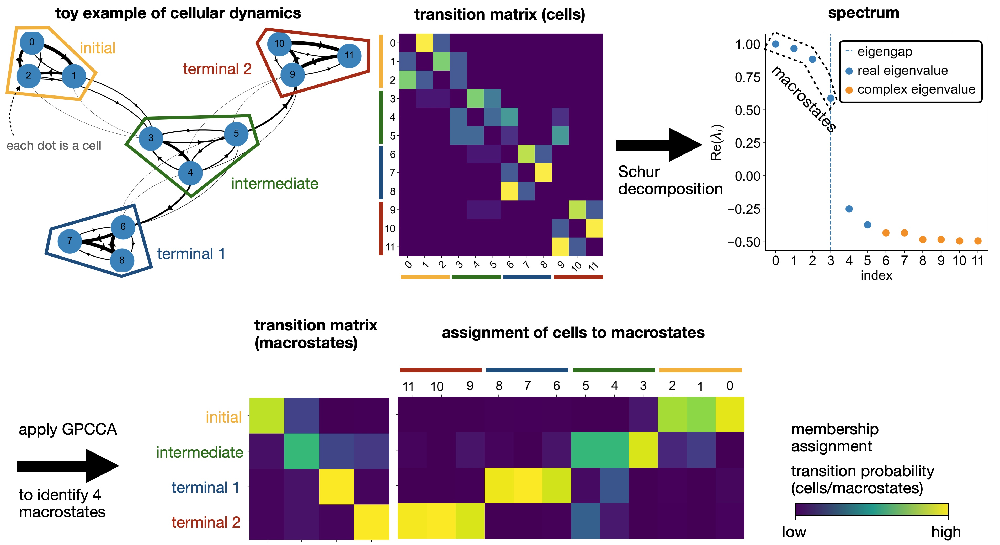
**Coarse-graining with GPCCA**: Using the GPCCA algorithm, CellRank coarse-grains a cell-cell transition matrix onto the macro-state level. We obtain two key outputs: the soft assignment of cells to macrostates, and a matrix of transition probabilities among these macrostates [Reuter et al., 2019, Reuter et al., 2022, Reuter et al., 2018].

Computing Schur decomposition


hwloc/linux: Ignoring PCI device with non-16bit domain.
Pass --enable-32bits-pci-domain to configure to support such devices
(warning: it would break the library ABI, don't enable unless really needed).


When computing macrostates, choose a number of states NOT in `[8, 10]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:01)
Calculating minChi criterion in interval `[3, 12]`
Computing `3` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:01)


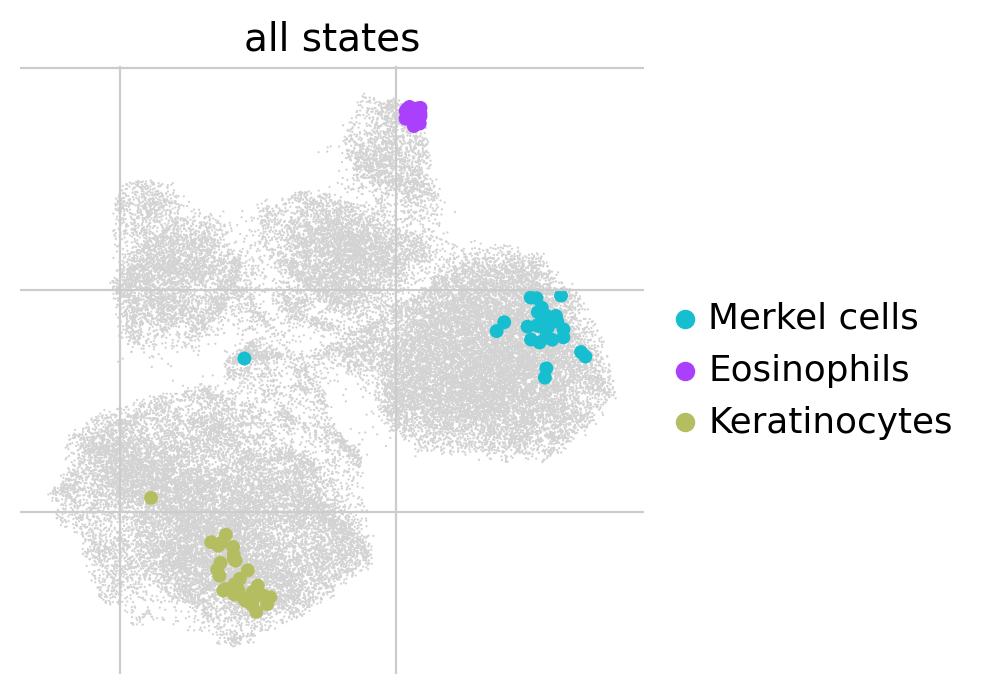

In [11]:
g.fit(cluster_key="cell_type", n_states=[2, 12])
g.plot_macrostates(which="all", discrete=True, legend_loc="right", s=100)

Using n_states=[a, b], we told the algorithm to scan this interval for the optimal number of macrostates. It identified 4 macrostates which we show above in the UMAP. For each macrostate, we display the n_cells cells most strongly associated with it. Each macrostate was automatically assigned a label by associating it with the cluster labels stored in adata.obs['clusters']; this is controled using cluster_key.

You can check out the pyGPCCA documentation for more information on the macrostate computation.

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


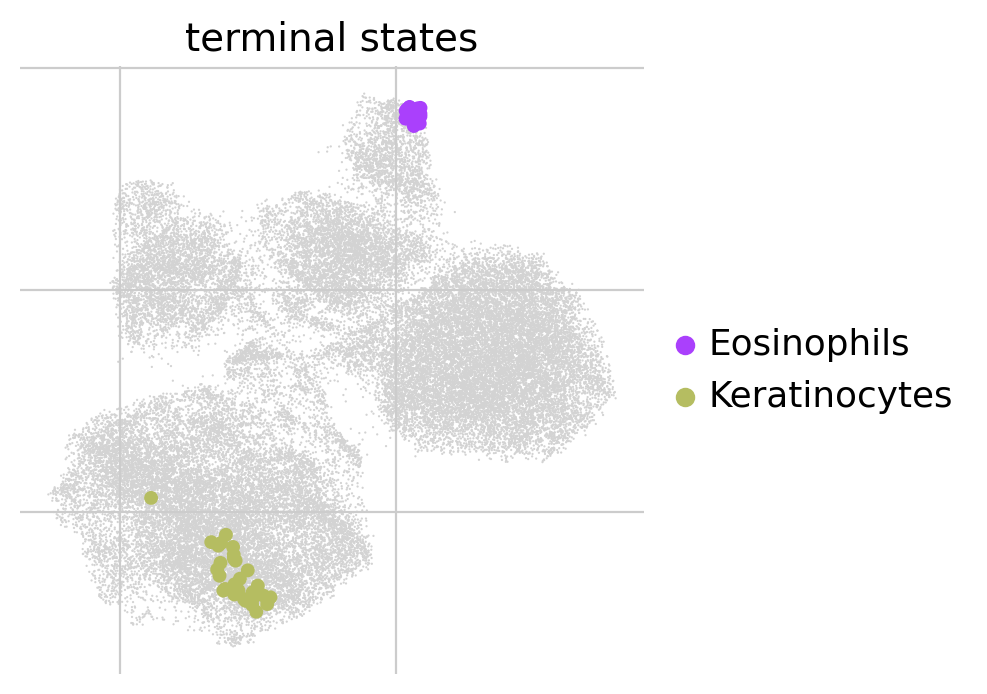

In [13]:
g.predict_terminal_states()
g.plot_macrostates(which="terminal", legend_loc="right", s=100)

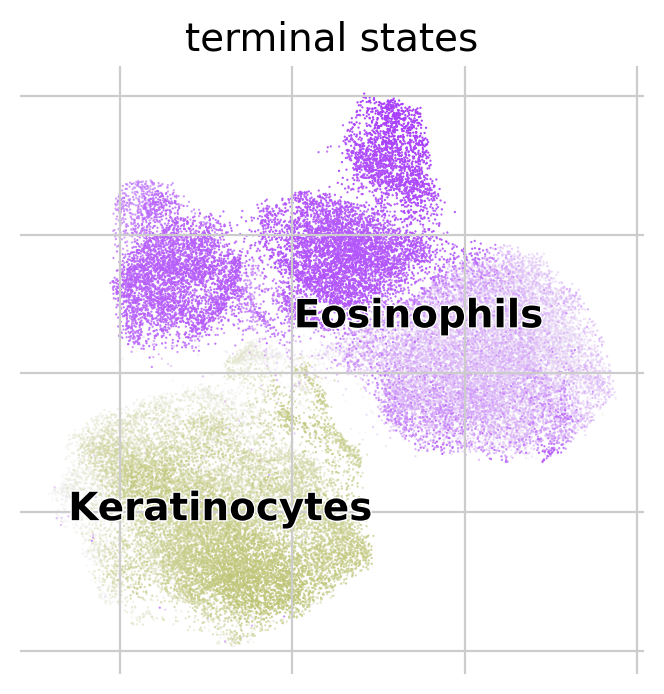

In [14]:
g.plot_macrostates(which="terminal", discrete=False)

Each cell is colored according to the terminal state it most likely belongs to; higher color intensity reflects greater confidence in the assignment.

Adding `adata.obs['init_states_fwd']`
       `adata.obs['init_states_fwd_probs']`
       `.initial_states`
       `.initial_states_probabilities`
       `.initial_states_memberships
    Finish`


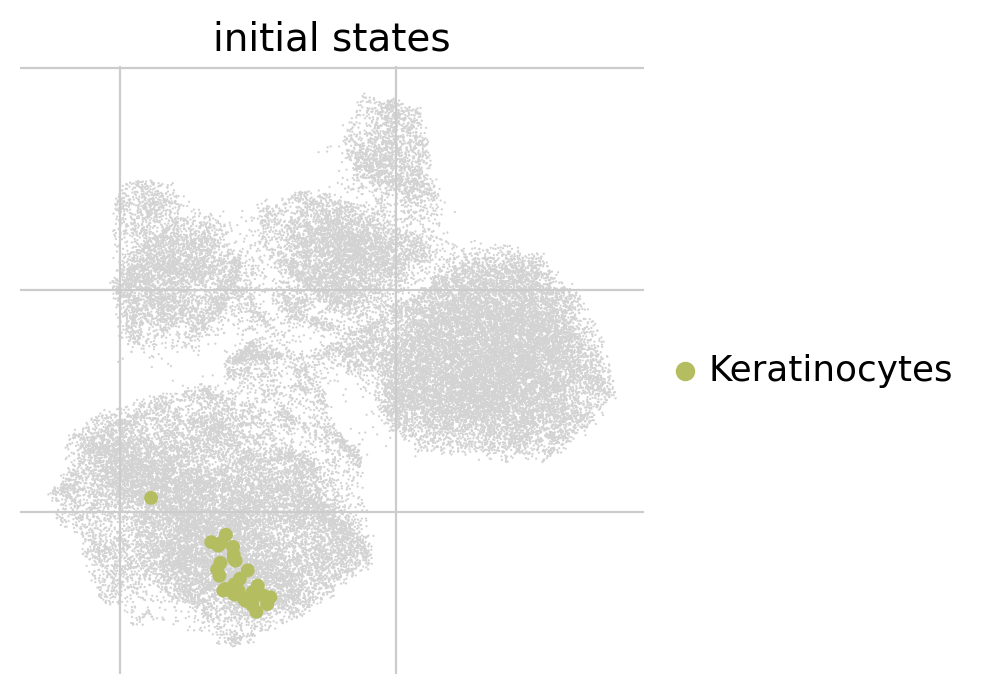

In [15]:
g.predict_initial_states(allow_overlap=True)
g.plot_macrostates(which="initial", legend_loc="right", s=100)

We can visually confirm our terminal state identification by comparing with know markers TRIM21, NLRC5 and PSMB9 for Eosinophils cells, DDX3Y, CDC20 and PDLIM7 for Keratinocytes cells. To confirm our initial state identification, we visualize Merkel cell markers EIF2S3, KDSR, ANKRD29.
+ PS : All these genes were identified in RNA velocity pipeline.

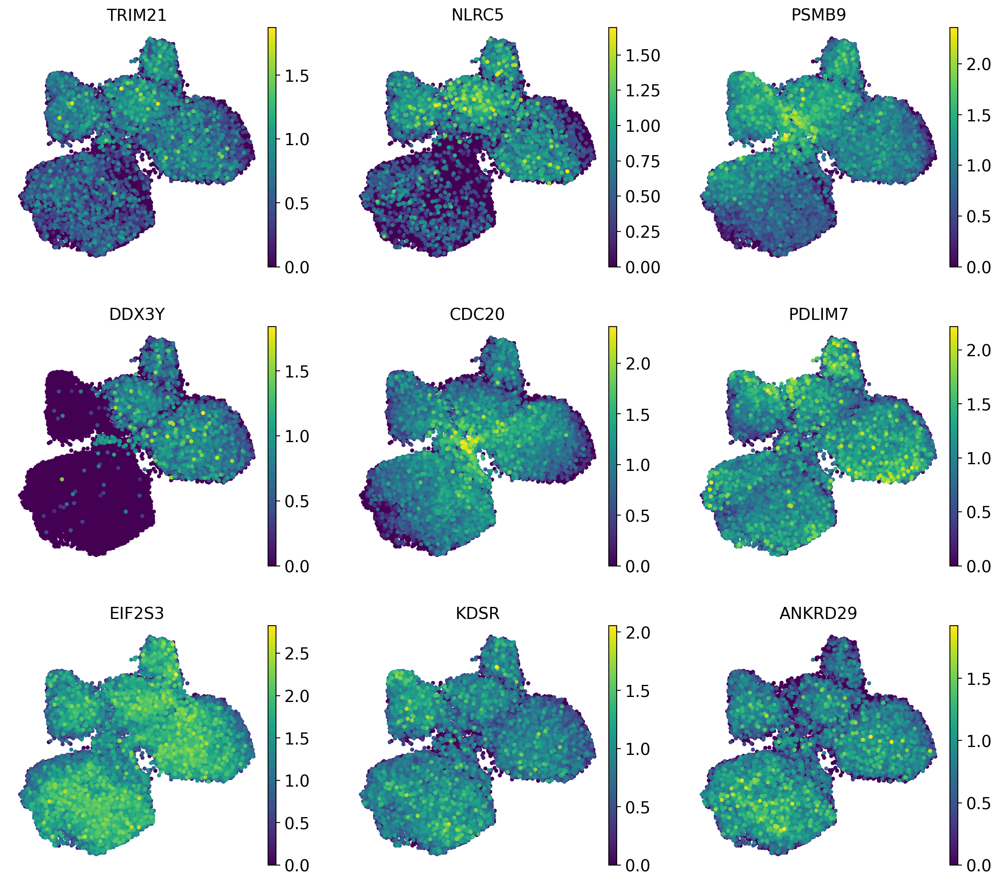

In [16]:
sc.pl.embedding(
    adata,
    basis="umap",
    color=["TRIM21", "NLRC5", "PSMB9", "DDX3Y", "CDC20", "PDLIM7", "EIF2S3", "KDSR", "ANKRD29"],
    size=50, ncols=3
)

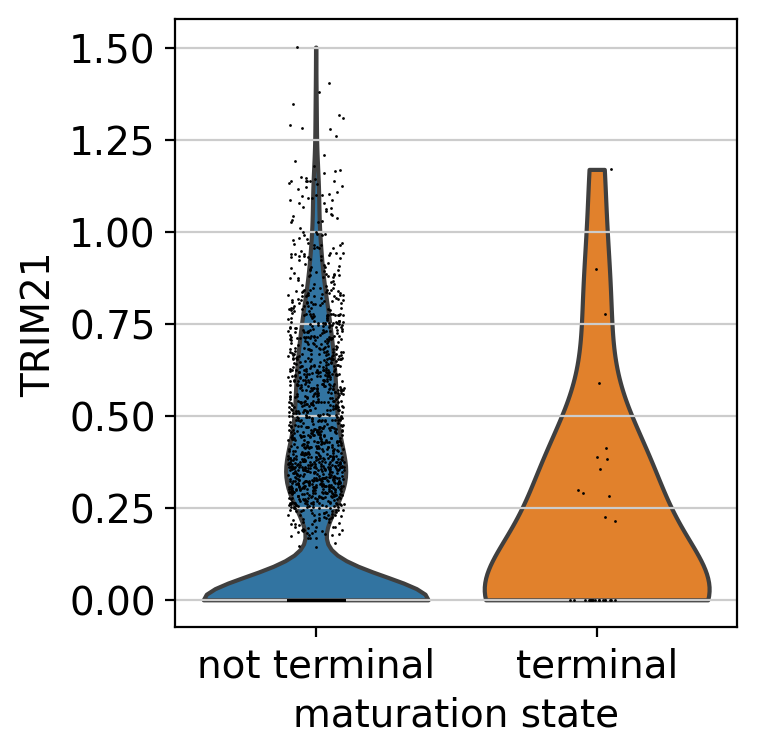

TtestResult(statistic=array([-0.5501105], dtype=float32), pvalue=array([0.5863526], dtype=float32), df=array([29.734512], dtype=float32))

In [17]:
# subset to just Beta cells
bdata = adata[adata.obs["cell_type"] == "Eosinophils"].copy()

# create an annotation for terminal vs. not-terminal
bdata.obs["maturation_state"] = np.where(
    bdata.obs["term_states_fwd"] == "Eosinophils", "terminal", "not terminal"
)

# show distribution in violin plot
sc.pl.violin(bdata, keys=["TRIM21"], groupby="maturation_state")

# use a simple t-test to quantify how different the two distributions are
a = bdata[bdata.obs["maturation_state"] == "terminal", "TRIM21"].X.data
b = bdata[bdata.obs["maturation_state"] == "not terminal", "TRIM21"].X.data
st.ttest_ind(a, b, equal_var=False)


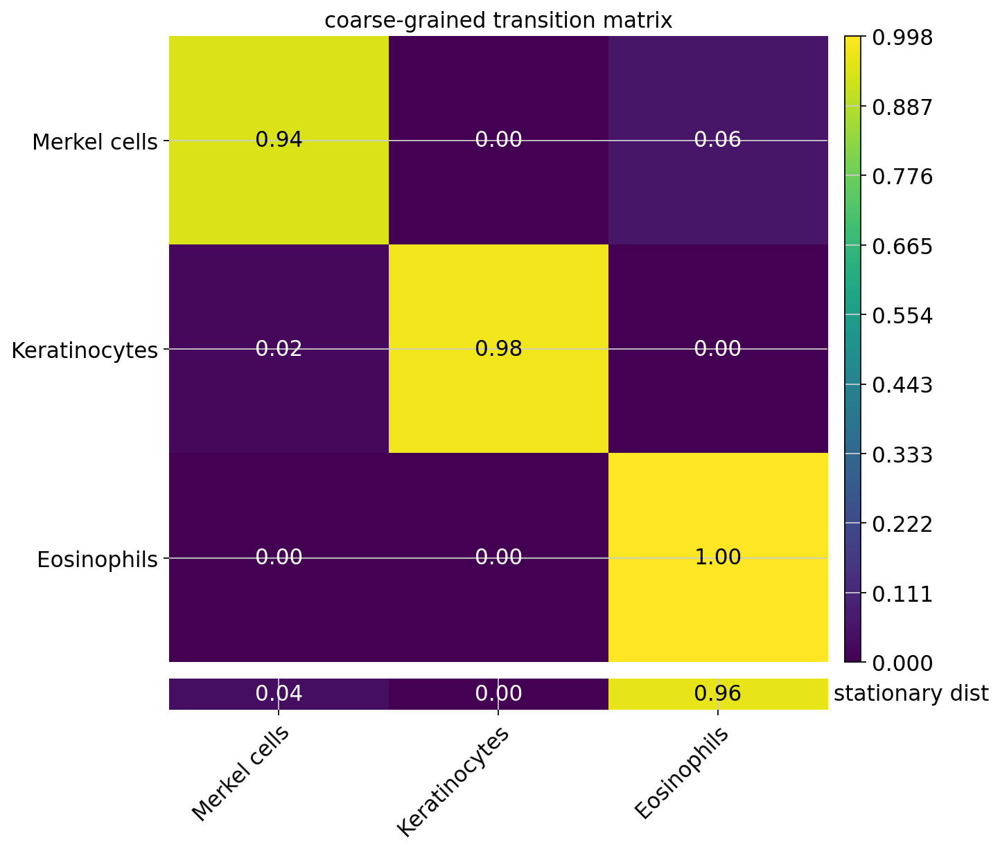

In [18]:
g.plot_coarse_T()

This transition matrix aggregates the single-cell Markov chain to a macrostate-level Markov chain. Entries in this matrix tell us how likely macrostates are to transition into one-another. We identify initial and terminal states based on the following criteria:

+ **`terminal_states`** are very stable (large value on the diagonal). They can have incoming probability mass, but almost no outgoing probability mass.

+ **`initial_states`** are less stable (smaller values on the diagonal and in the coarse-grained stationary distribution). They can have outgoing, but almost no incoming probability mass.

+ **`intermediate states`** are just all remaining macrostates which we classified neither as terminal nor as initial.

Note that the automatic identification does not always work perfectly. For example, we did not automatically identify the initial Merkel cell population in our analysis above. For this reason, we’ll next explore the low-level mode to interact with the GPCCA estimator which offers a bit more control and supervision to bring in any prior knowledge that you might have about the biological system.

### Advanced usage
Let’s start with a new estimator object.

In [19]:
g2 = cr.estimators.GPCCA(vk)
print(g2)

GPCCA[kernel=VelocityKernel[n=46110], initial_states=None, terminal_states=None]


The computation of macrostates is based on the real Schur decomposition - essentially a generalization of the eigendecomposition. For non-symmetric transition matrices, as in our case, the eigendecomposition in general yields complex eigenvalues and eigenvectors, which are difficult to interpret. Thus, we revert to the real Schur decomposition [Reuter et al., 2019, Reuter et al., 2018].

Below, we also plot the real part of the top eigenvalues, sorted by their real part. Blue and orange denote real and complex eigenvalues, respectively. For real matrices, complex eigenvalues always appear in pairs of complex conjugates.

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[8, 10, 15, 18, 20]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:03)


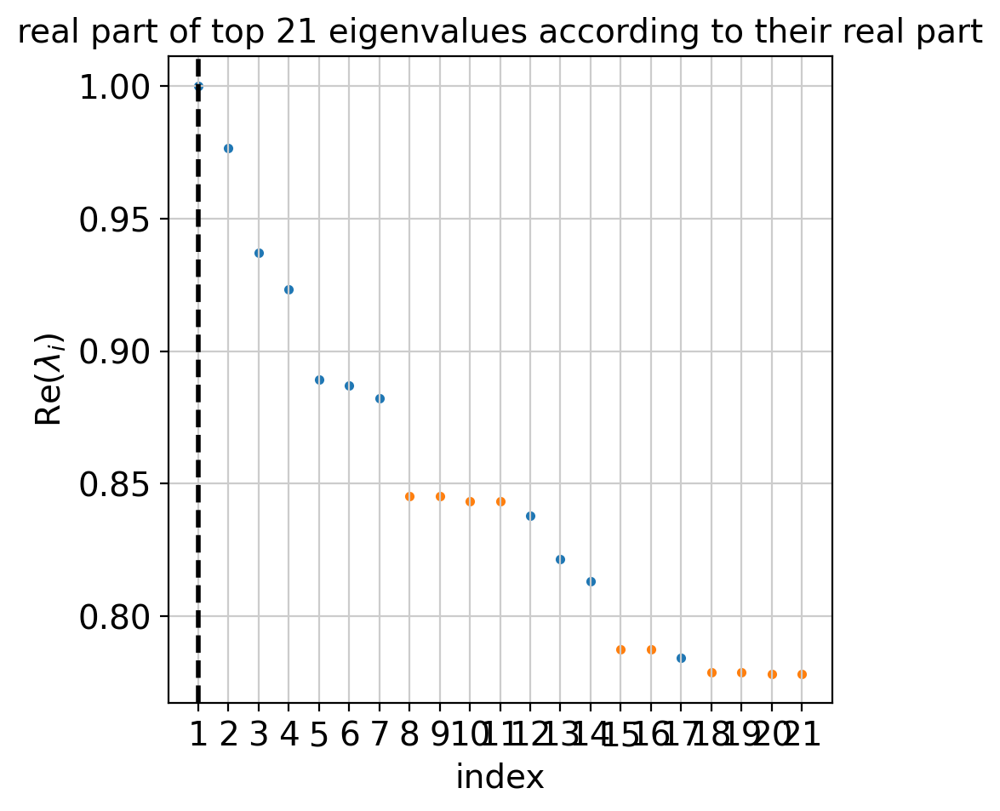

In [20]:
g2.compute_schur()
g2.plot_spectrum(real_only=True)

Using the real Schur decomposition, we compute macrostates. In the plot above, the estimator automatically suggested a number of states to use (dashed vertical line); however, we will ignore that and compute a few more states to have a chance at identifying the Merkel cell population.

Computing `5` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:02)


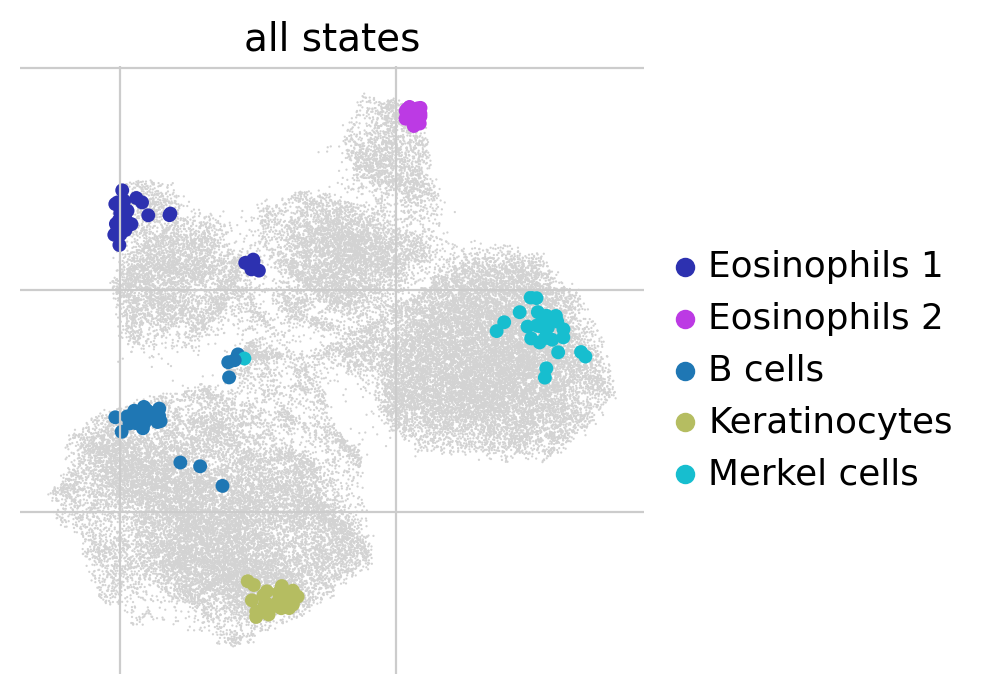

In [21]:
g2.compute_macrostates(n_states=5, cluster_key="cell_type")
g2.plot_macrostates(which="all", legend_loc="right", s=100)

We now have macrostates for Alpha, Beta, Epsilon and Delta populations, besides a few progenitor populations. We assign one label per macrostate based on the underlying 'clusters' annotation. However, that does not imply that all cells within one macrostate are from the same underlying cluster as we use majority voting. We can visualize the relationship between clusters and macrostates. We show below the distribution over cluster membership for each of the cells most confidently assigned to a certain macrostate.

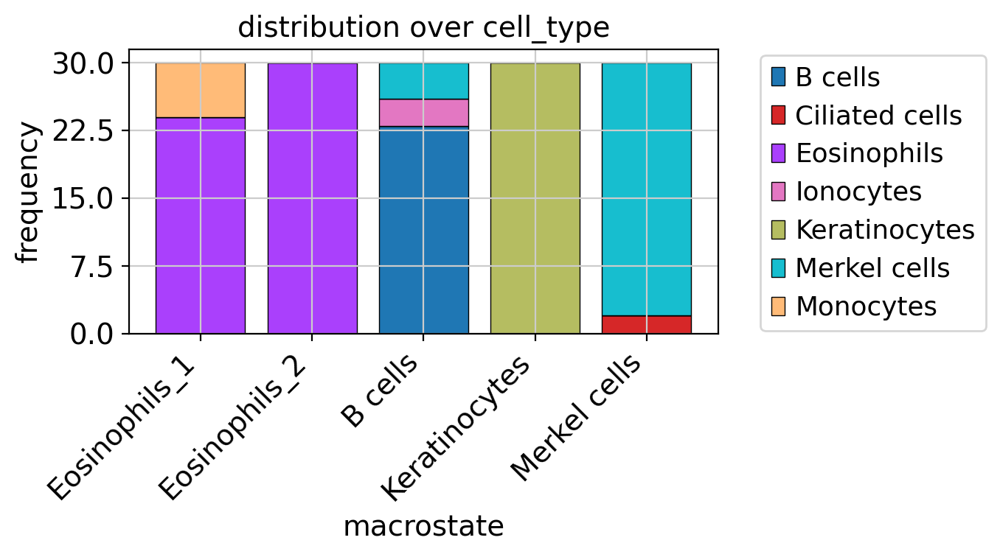

In [22]:
g2.plot_macrostate_composition(key="cell_type", figsize=(7, 4))

With some exceptions, most macrostates recruit their top-cells from a single underlying cluster. This plotting function works for any observation-level covariate and can be useful when we have experimental time labels as we expect more mature states to come from later time points. See the RealTimeKernel and the corresponding tutorial to learn how CellRank makes use of experimental time points.

To get an idea of how these macrostates are related, we plot the coarse-grained transition matrix.

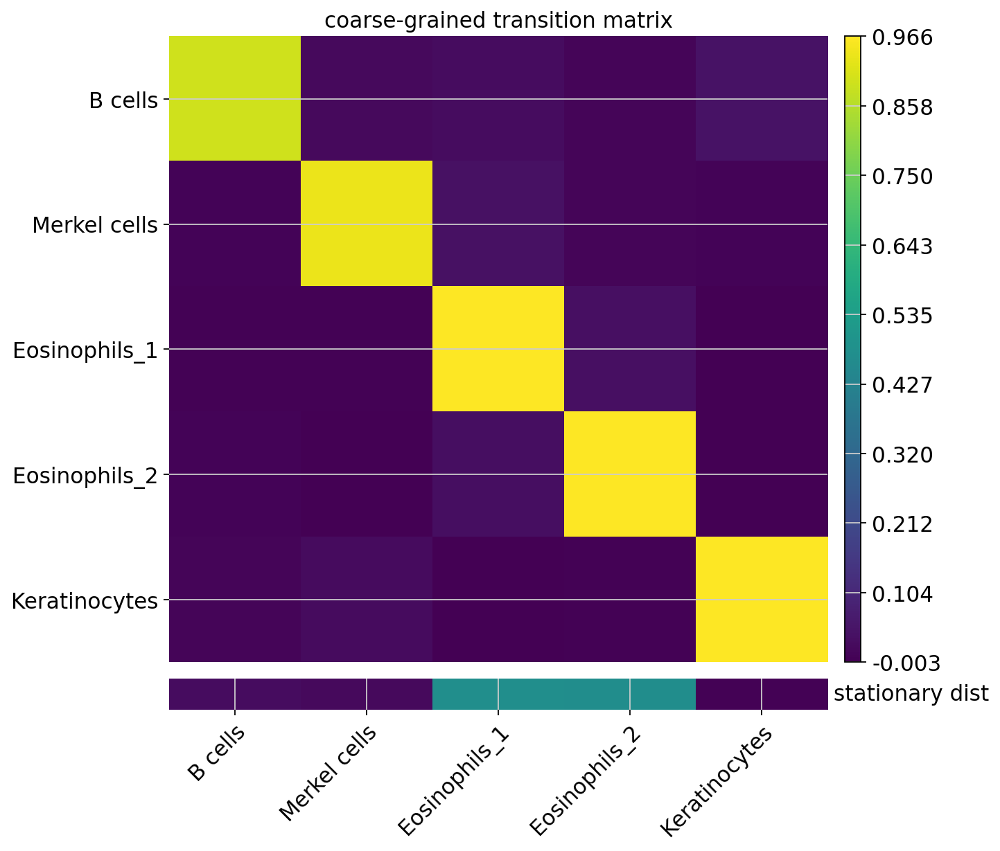

In [23]:
g2.plot_coarse_T(annotate=False)

By default, macrostates are ordered according to their diagonal value, increasing from left to right. The diagonal value is a proxy for a states’ metastability, i.e. the probability of leaving the state once entered. While the Epsilon, Alpha and Beta states have high diagonal values, Delta cells have a low value because they are predicted to transition into Beta cells (check the corresponding matrix element).

Let’s try automatic terminal state identification.

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


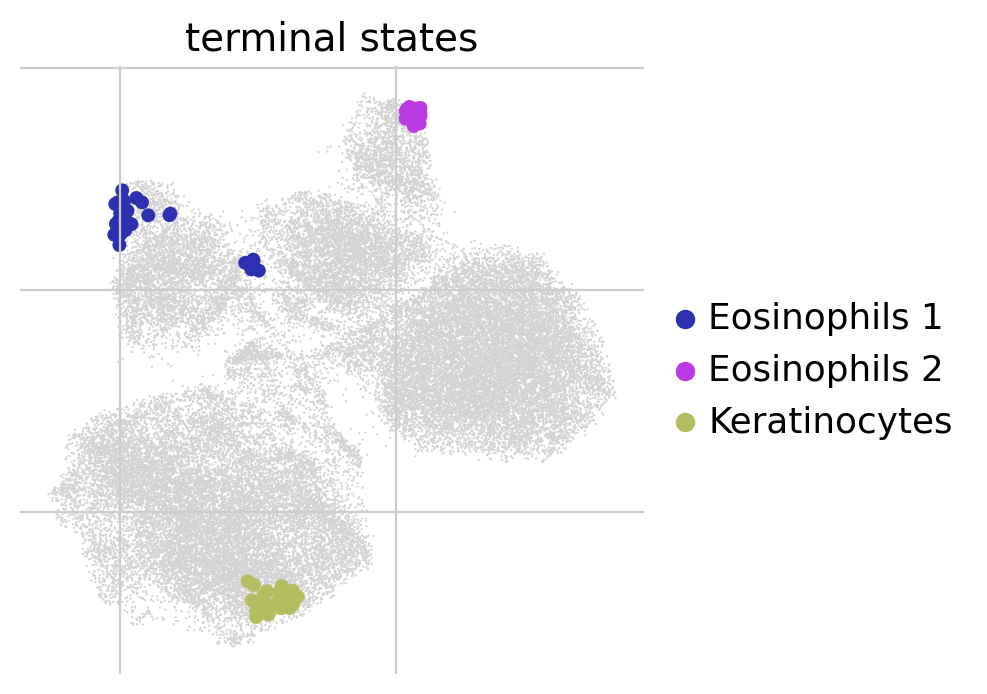

In [24]:
g2.predict_terminal_states()
g2.plot_macrostates(which="terminal", legend_loc="right", s=100)

Besides many more macrostates being present now, this consistently identified the same three terminal states as before. However, we still did not catch the Delta cells! If we want to compute fate probabilities towards them later on, we need to annotate them as a terminal state. Luckily, this can be done semi-automatically as well:

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


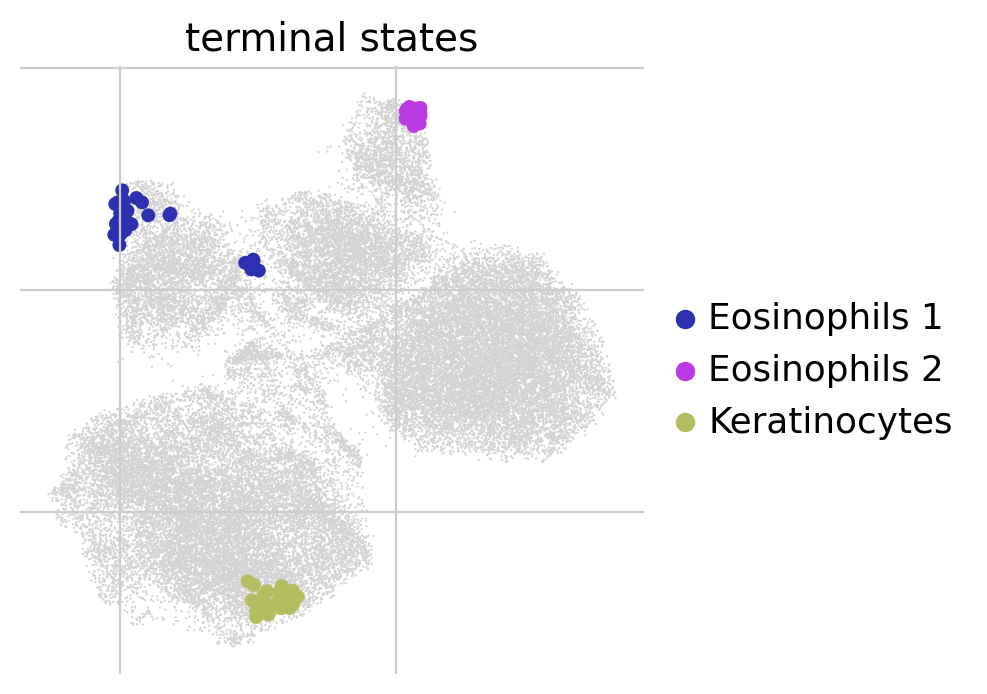

In [25]:
g2.set_terminal_states(states=["Eosinophils_1", "Eosinophils_2", "Keratinocytes"])
g2.plot_macrostates(which="terminal", legend_loc="right", s=100)

We call this semi-automatic terminal state identification as we manually pass the macrostates we would like to select, however, the actual cells belonging to each macrostate are assigned automatically. For initial states, everything works exactly the same, you can identify them fully automatically, or semi-automatically. Let’s compute the initial states fully automatically here:

Adding `adata.obs['init_states_fwd']`
       `adata.obs['init_states_fwd_probs']`
       `.initial_states`
       `.initial_states_probabilities`
       `.initial_states_memberships
    Finish`


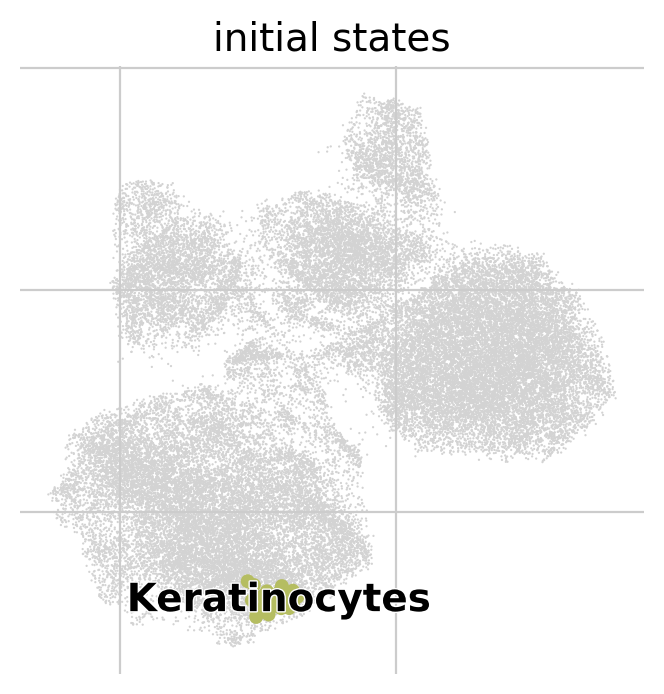

In [26]:
g2.predict_initial_states(allow_overlap=True)
g2.plot_macrostates(which="initial", s=100)

How can we check whether this is really the correct initial state? In this case, we have prior knowledge that we can use: we know that the initial state should be high for a number of B cell markers. So let’s use these markers to compute a score that we can visualize across macrostates to confirm that we have the correct one.

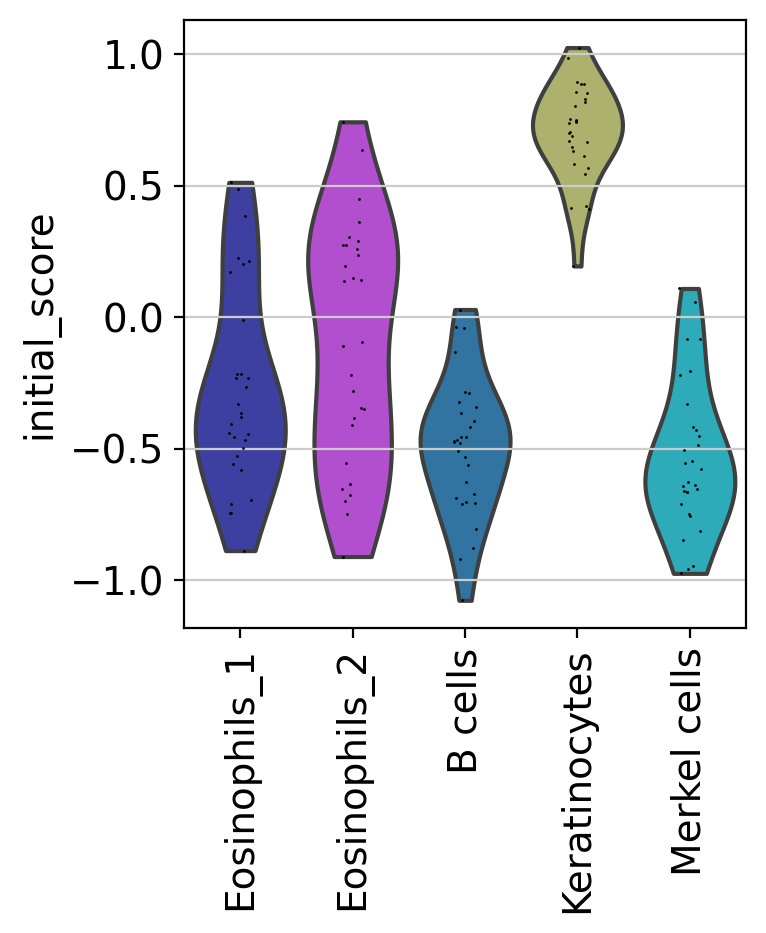

In [27]:
# compute a score in scanpy by aggregating across a few ductal markers
sc.tl.score_genes(
    adata, gene_list=["YWHAE", "CALR", "DCBLD2"], score_name="initial_score"
)

# write macrostates to AnnData
adata.obs["macrostates"] = g2.macrostates
adata.uns["macrostates_colors"] = g2.macrostates_memberships.colors

# visualize via heatmaps
sc.pl.violin(adata, keys="initial_score", groupby="macrostates", rotation=90)


How can we check whether this is really the correct terminal state? In this case, we have prior knowledge that we can use: we know that the initial state should be high for a number of Gamma T cell markers. So let’s use these markers to compute a score that we can visualize across macrostates to confirm that we have the correct one.

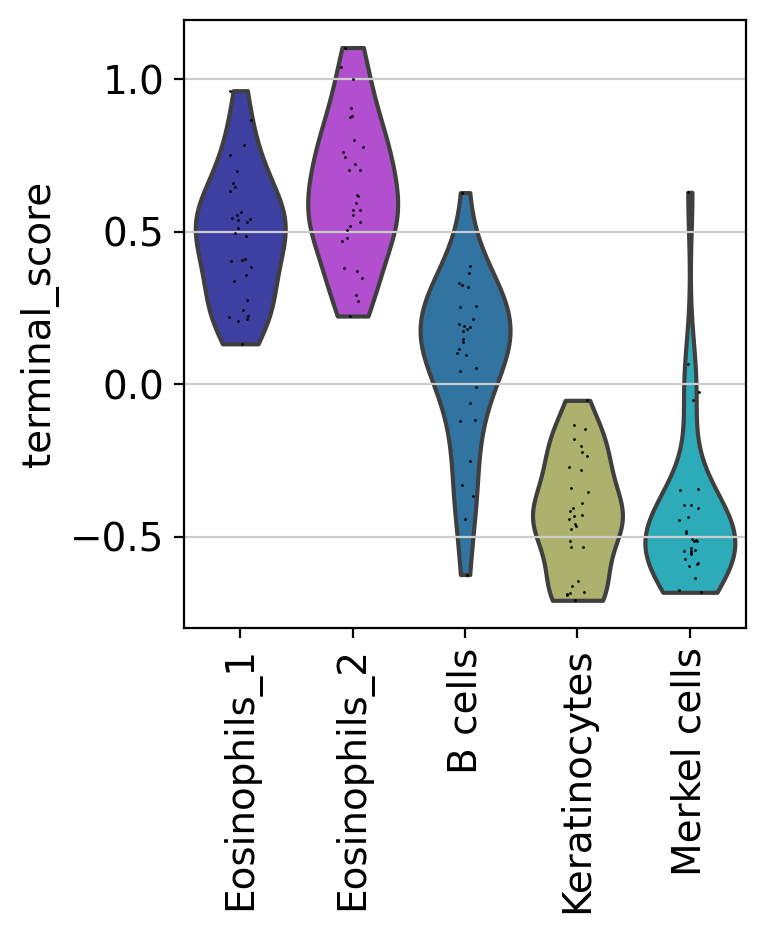

In [28]:
# compute a score in scanpy by aggregating across a few ductal markers
sc.tl.score_genes(
    adata, gene_list=["EIF2AK2", "NLRC5", "IFI6", "STAT1"], score_name="terminal_score"
)

# write macrostates to AnnData
adata.obs["macrostates"] = g2.macrostates
adata.uns["macrostates_colors"] = g2.macrostates_memberships.colors

# visualize via heatmaps
sc.pl.violin(adata, keys="terminal_score", groupby="macrostates", rotation=90)

# Estimating Fate Probabilities and Driver Genes

## Preliminaries
In this tutorial, you will learn how to:

compute and visualize fate probabilities towards terminal states.

aggregate fate probabilities over groups of cells to uncover fate-biased populations.

correlate fate probabilities with gene expression to detect putative driver genes of fate decisions.
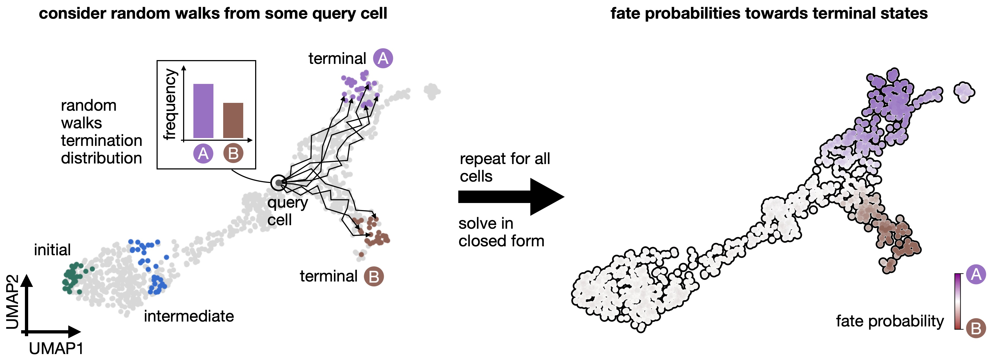
**`Quantifying cellular fate bias with absorption probabilities`**: For each cell that is not assigned to a terminal state, we estimate its fate probabilities of reaching any terminal state. To compute fate probabilities, we consider random walks, starting from the query cell, and count how often these end up in each terminal state. We repeat this many times and use the arrival frequencies in terminal states as fate probabilities. Luckily, we do not actually have to simulate random walks: we use absorption probabilities on the Markov chain, which quantify these arrival frequencies for an infinite number of random walks [Lange et al., 2022].

## Estimate cellular fate bias
### Compute fate probabilities
We compute fate_probabilities by aggregating over all random walks that start in a given cell and end in some terminal population. There exists an analytical solution to this problem called absorption probabilities, their computation is 30x faster in CellRank 2 compared to version 1 and scales to millions of cells.

conda install -c conda-forge petsc4py=3.19.0 slepc4py to solve the error:  'petsc4py.PETSc.KSP' object has no attribute 'converged'

Computing fate probabilities


  0%|          | 0/3 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)


AttributeError: 'Colorbar' object has no attribute 'draw_all'

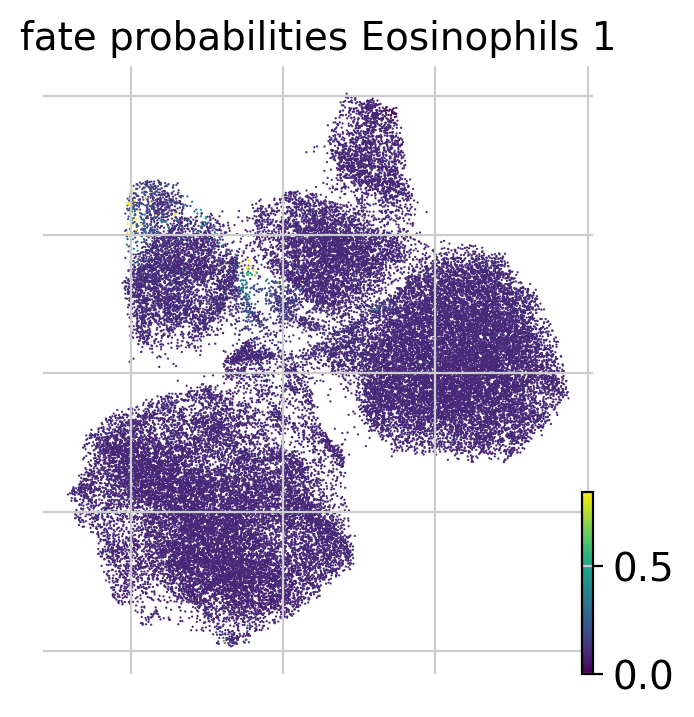

In [47]:
g2.compute_fate_probabilities()
g2.plot_fate_probabilities(same_plot=False)

/home/aruna/anaconda3/envs/RNAvelocity/lib/python3.11/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


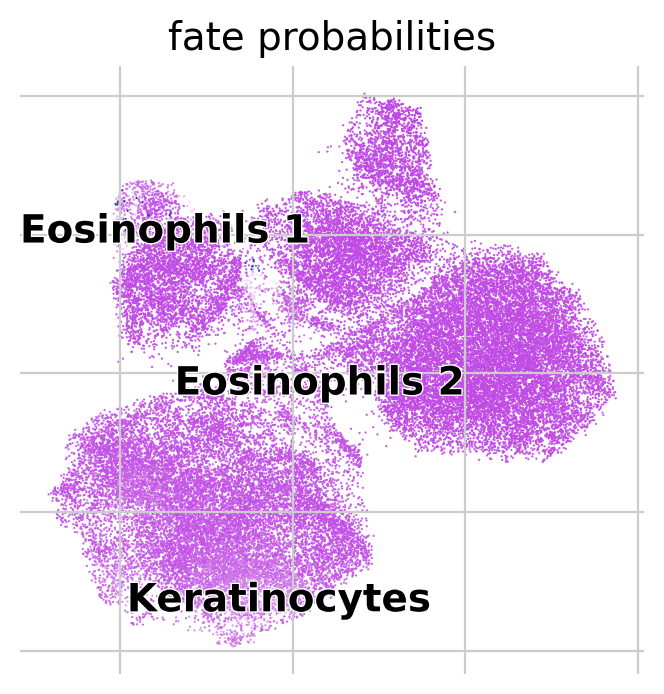

In [48]:
g2.plot_fate_probabilities(same_plot=True)

/home/aruna/anaconda3/envs/RNAvelocity/lib/python3.11/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
/home/aruna/anaconda3/envs/RNAvelocity/lib/python3.11/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


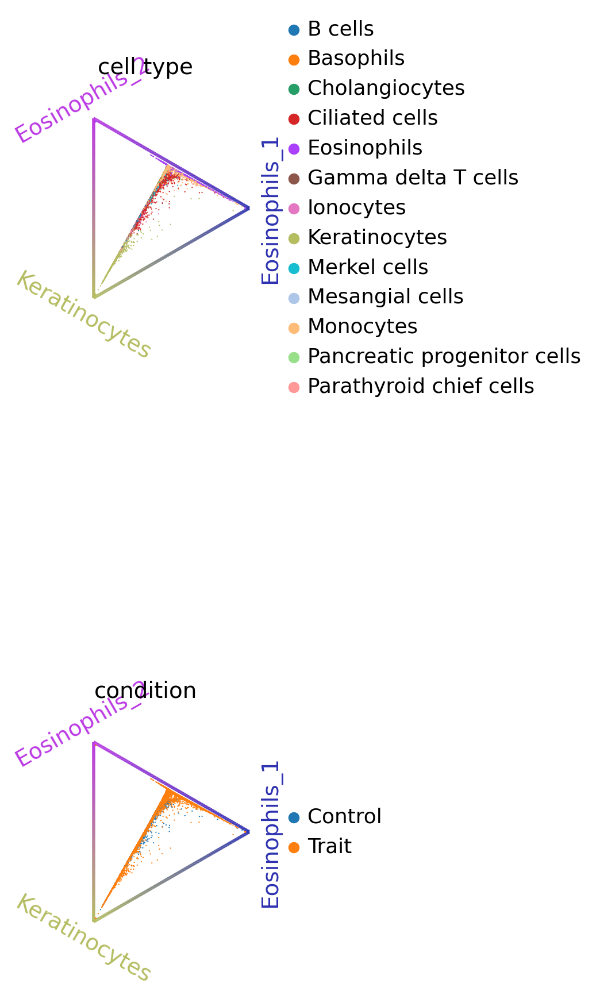

In [72]:
cr.pl.circular_projection(adata, keys=['cell_type', 'condition'], legend_loc="right", space=1.5, ncols=1)

## Aggregate fate probabilities
Often, we are interested in aggregated fate probabilities over a group of cells, like a cell- type or state. As an example, let’s focus on the Fev+ progenitor populations, and their fate commitment towards Delta cells. Let’s start with an overview of these subpopulations.

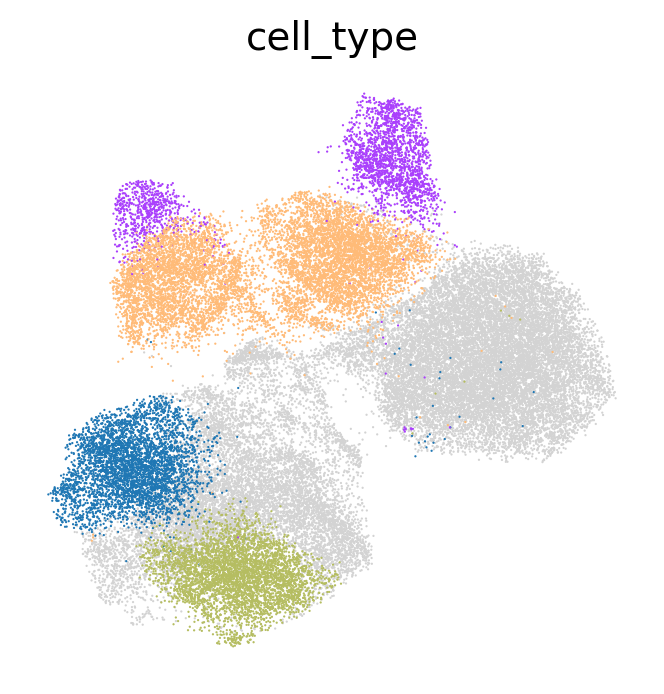

In [74]:
term_states = ["Eosinophils", "B cells", "Monocytes", "Keratinocytes"]
sc.pl.embedding(
    adata, basis="umap", color="cell_type", groups=term_states, legend_loc="right"
)

/home/aruna/anaconda3/envs/RNAvelocity/lib/python3.11/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


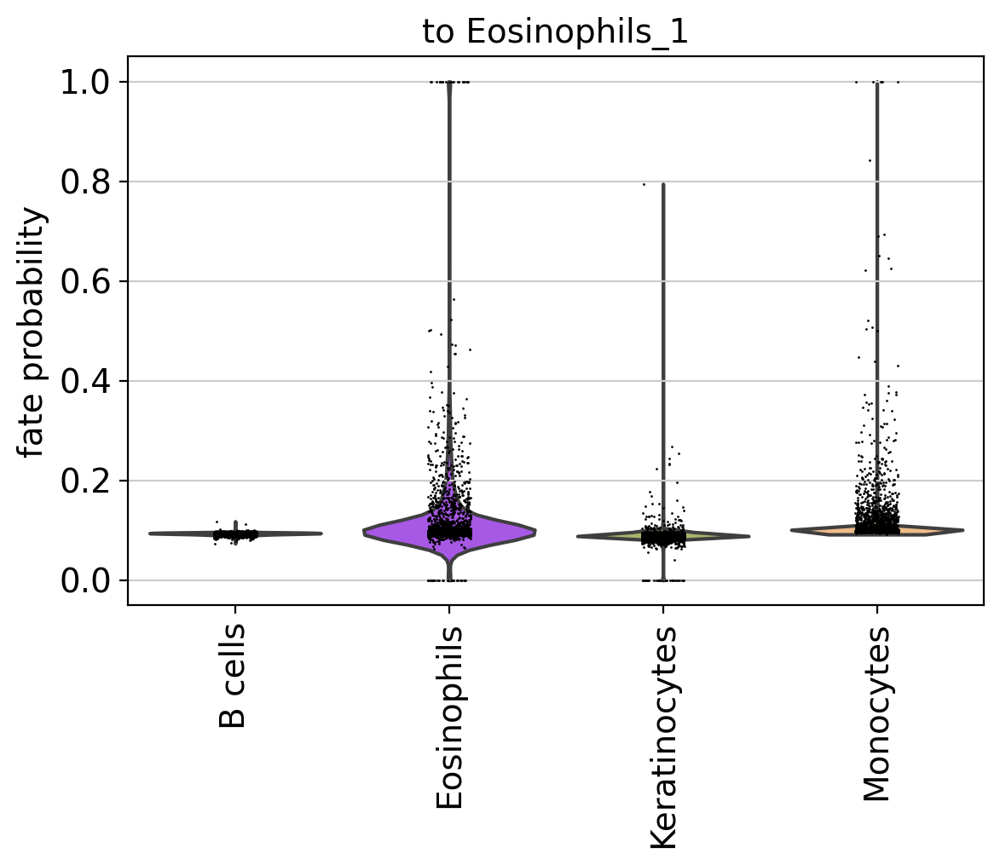

In [75]:
cr.pl.aggregate_fate_probabilities(
    adata,
    mode="violin",
    lineages=["Eosinophils_1"],
    cluster_key="cell_type",
    clusters=term_states,
)

/home/aruna/anaconda3/envs/RNAvelocity/lib/python3.11/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


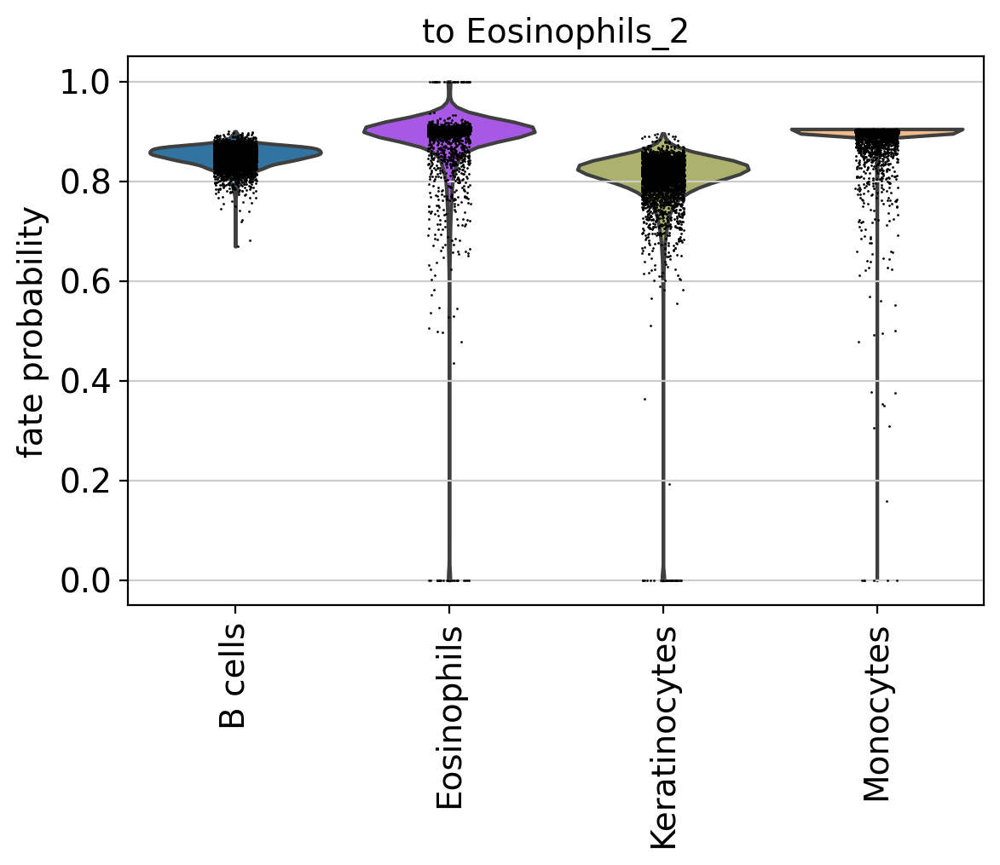

In [76]:
cr.pl.aggregate_fate_probabilities(
    adata,
    mode="violin",
    lineages=["Eosinophils_2"],
    cluster_key="cell_type",
    clusters=term_states,
)

/home/aruna/anaconda3/envs/RNAvelocity/lib/python3.11/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


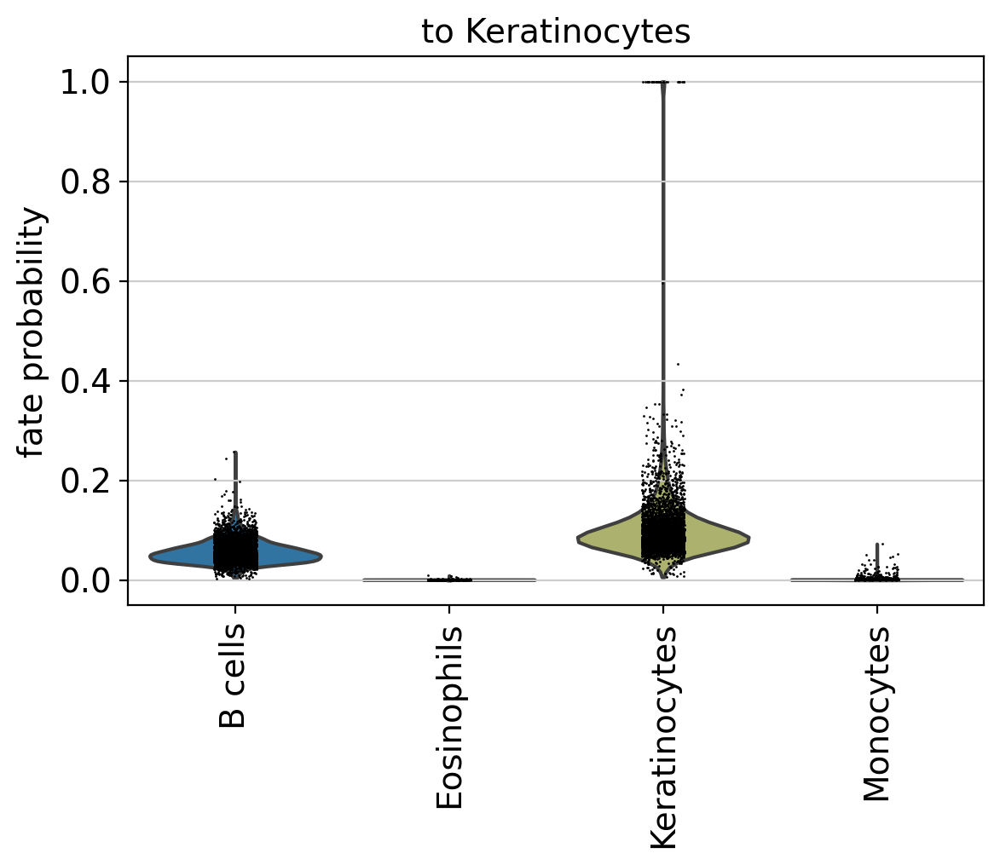

In [77]:
cr.pl.aggregate_fate_probabilities(
    adata,
    mode="violin",
    lineages=["Keratinocytes"],
    cluster_key="cell_type",
    clusters=term_states,
)

## Uncover driver genes
### Correlate fate probabilities with gene expression
We uncover putative driver genes by correlating fate probabilities with gene expression using the compute_lineage_drivers() method. In other words, if a gene is systematically higher or lower expressed in cells that are more or less likely to differentiate towards a given terminal states, respectively, then we call this gene a putative driver gene.

As an example, let’s focus on Delta cell generation again, and let’s restrict the correlation-computation to the relevant clusters.

In [78]:
driver_clusters = ["Eosinophils", "B cells", "Monocytes", "Keratinocytes"]

delta_df = g.compute_lineage_drivers(
    lineages=["Eosinophils"], cluster_key="cell_type", clusters=driver_clusters
)
delta_df.head(10)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:01)


,Eosinophils_corr,Eosinophils_pval,Eosinophils_qval,Eosinophils_ci_low,Eosinophils_ci_high
IFIT1,0.444854,0.0,0.0,0.433605,0.455964
IFIT3,0.441490,0.0,0.0,0.430200,0.452643
IFIT2,0.412880,0.0,0.0,0.401252,0.424375
MX1,0.361210,0.0,0.0,0.349030,0.373269
OAS1,0.353998,0.0,0.0,0.341747,0.366129
IFI27,0.350496,0.0,0.0,0.338211,0.362662
APOL2,0.349905,0.0,0.0,0.337614,0.362077
OASL,0.342420,0.0,0.0,0.330058,0.354665
ISG20,0.328623,0.0,0.0,0.316134,0.340999
IRF1,0.318072,0.0,0.0,0.305489,0.330544


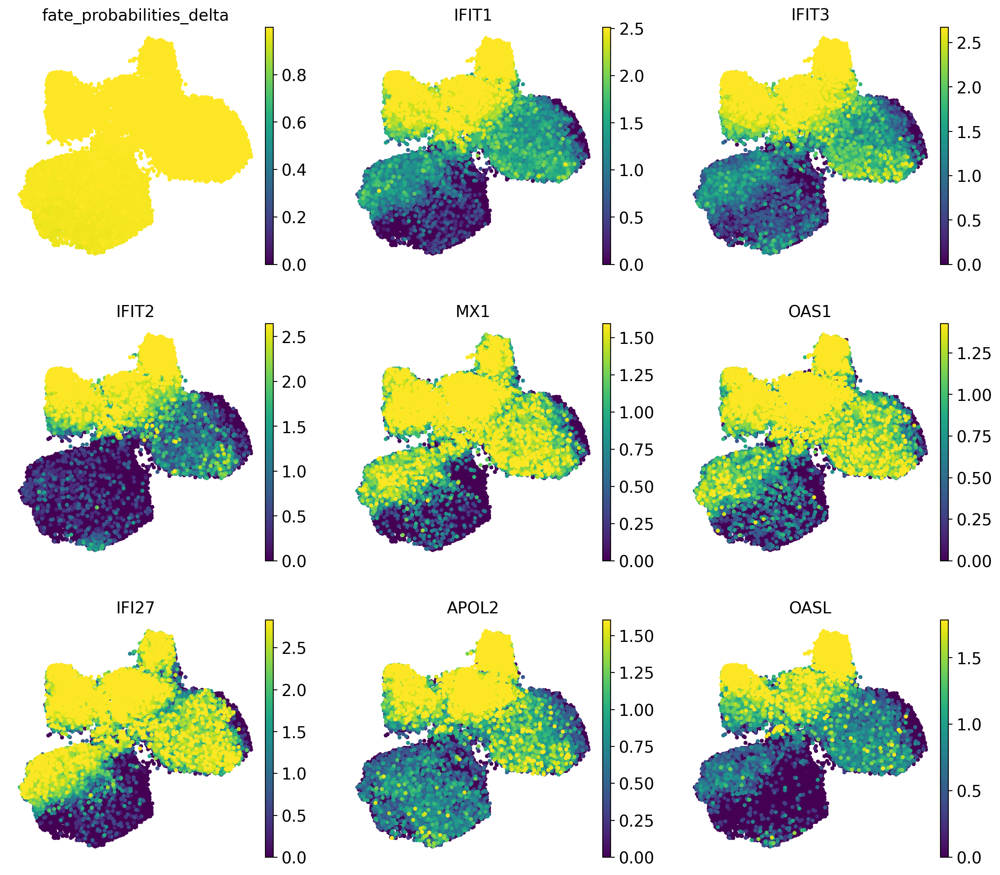

In [82]:
adata.obs["fate_probabilities_delta"] = g.fate_probabilities["Eosinophils"].X.flatten()

sc.pl.embedding(
    adata,
    basis="umap",
    color=["fate_probabilities_delta"] + list(delta_df.index[:8]),
    color_map="viridis",
    s=50,
    ncols=3,
    vmax="p96",
)

In [83]:
cr.logging.print_versions()

cellrank==2.0.0 scanpy==1.9.6 anndata==0.10.3 numpy==1.26.0 numba==0.58.1 scipy==1.11.3 pandas==1.4.1 pygpcca==1.0.4 scikit-learn==1.3.2 statsmodels==0.14.0 python-igraph==0.11.2 scvelo==0.2.5 pygam==0.8.0 matplotlib==3.8.1 seaborn==0.12.2
